## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

# 1- Camera Calibration 

## 1.1- Finding corners

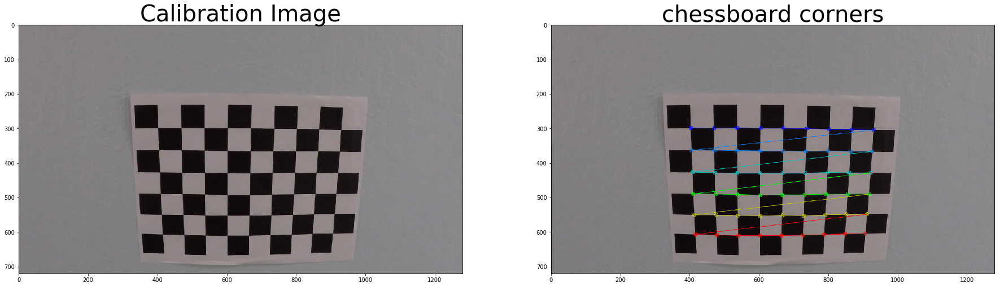

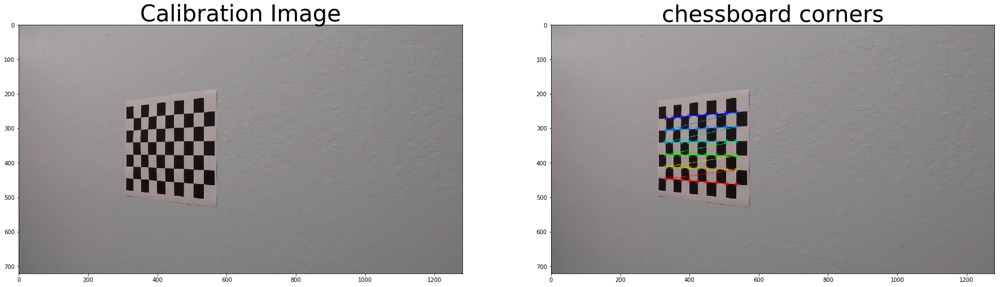

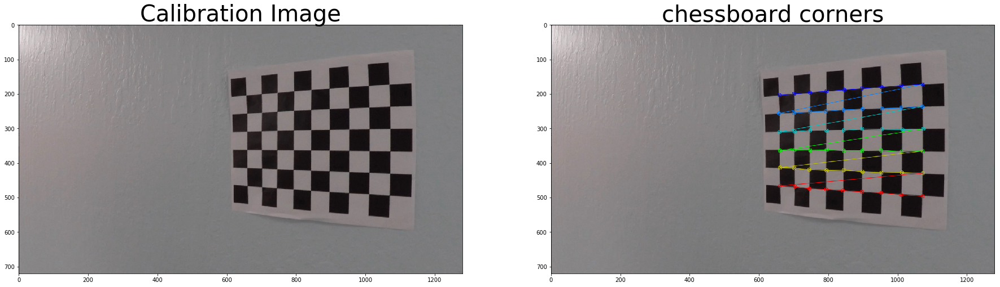

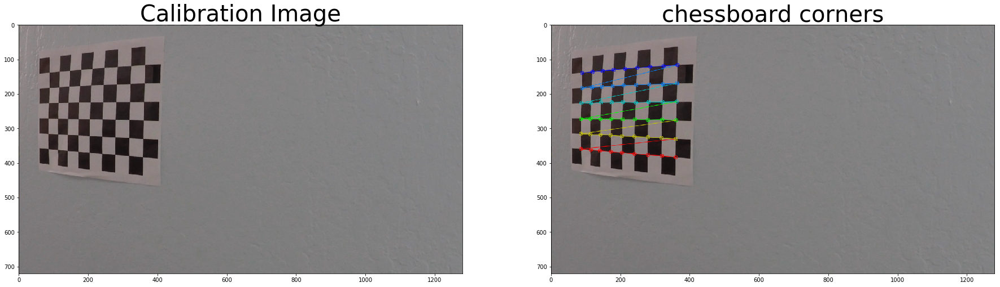

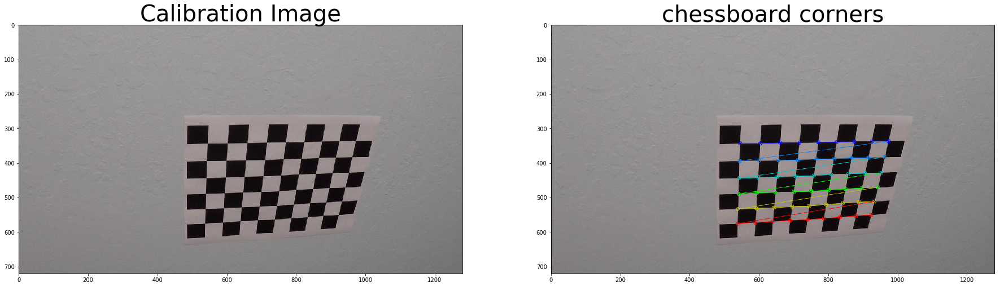

...

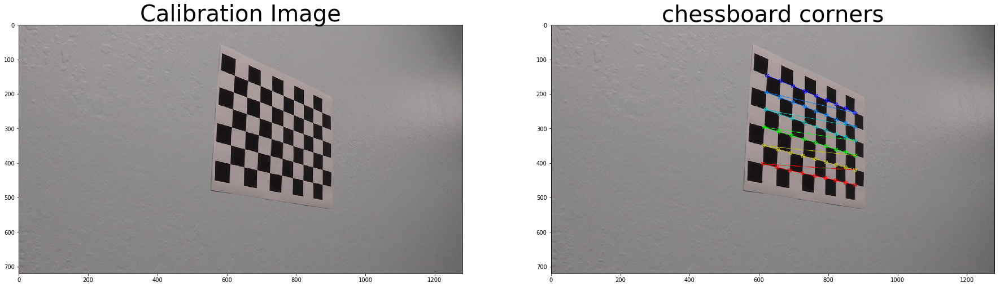

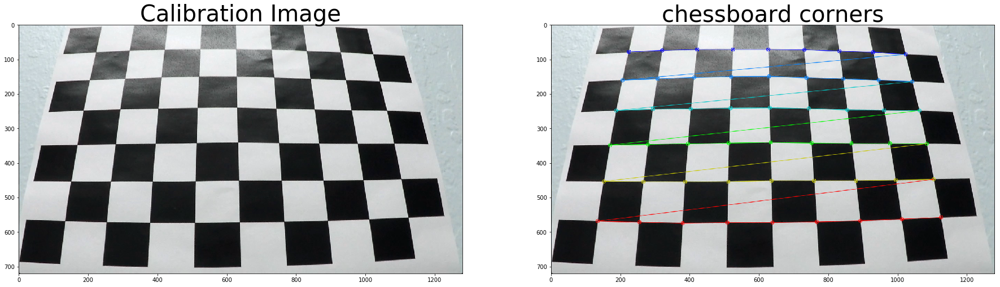

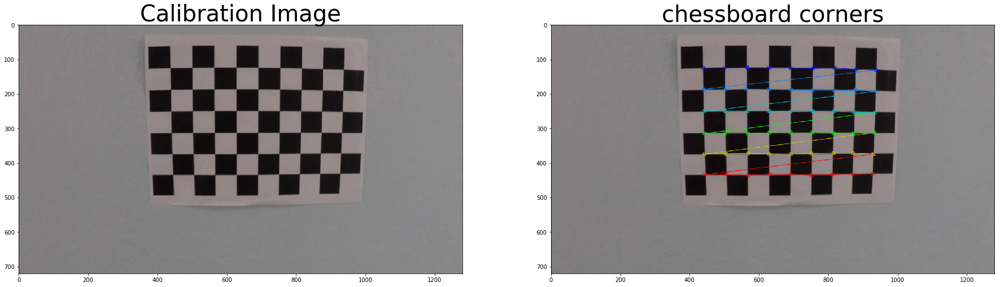

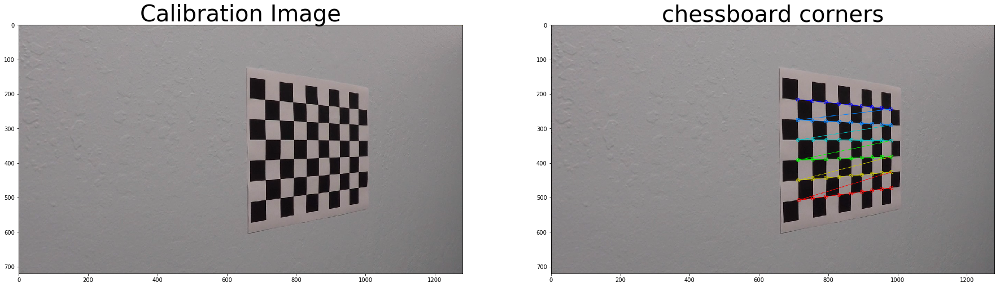

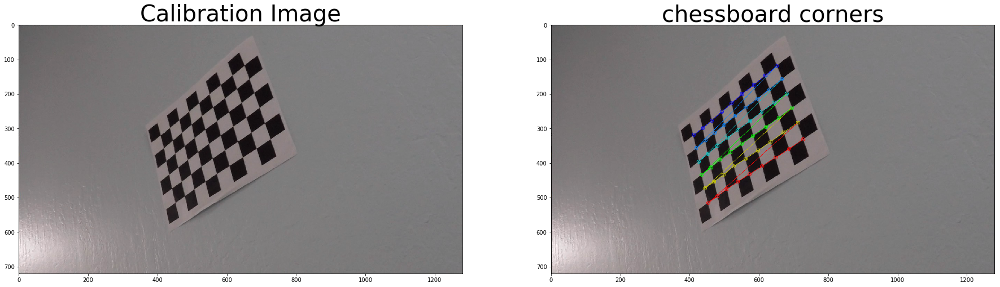

In [9]:
# Importing libraries
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

# chess board number of corners
nx = 9
ny = 6

# Reading the calibration images paths
cal_paths = glob.glob('camera_cal/calibration*.jpg')

# Preparing the object and image points.
obj_points = []
img_points = []
objps = np.zeros((6*9,3),np.float32)
objps[:,:2] =np.mgrid[0:9,0:6].T.reshape(-1,2)


for path in  cal_paths:
    #Reading a calibration image
    clb_image = cv2.imread(path)
    
    # Converting image to grayscale
    gray = cv2.cvtColor(clb_image, cv2.COLOR_BGR2GRAY)
    
    # Finding chess board corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
   
    if ret == True:
        #plotting the original image
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        ax1.set_title('Calibration Image', fontsize=40)
        ax1.imshow(clb_image)
        
        #drawing the chessboard corners
        crn_image = cv2.drawChessboardCorners(clb_image,(nx,ny),corners,ret)
        #adding the image corners
        img_points.append(corners)
        obj_points.append(objps)
        
            
        # Plotting the images
        ax2.imshow(crn_image)
        ax2.set_title('chessboard corners', fontsize=40)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()
        

# Computing t he calibration matrix
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj_points,img_points, gray.shape[::-1],None, None)


## 1.2- Undistorting images 

conversion matrix:  [[  1.15396093e+03   0.00000000e+00   6.69705357e+02]
 [  0.00000000e+00   1.14802496e+03   3.85656234e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
distortion matrix:  [[ -2.41017956e-01  -5.30721173e-02  -1.15810355e-03  -1.28318856e-04
    2.67125290e-02]]


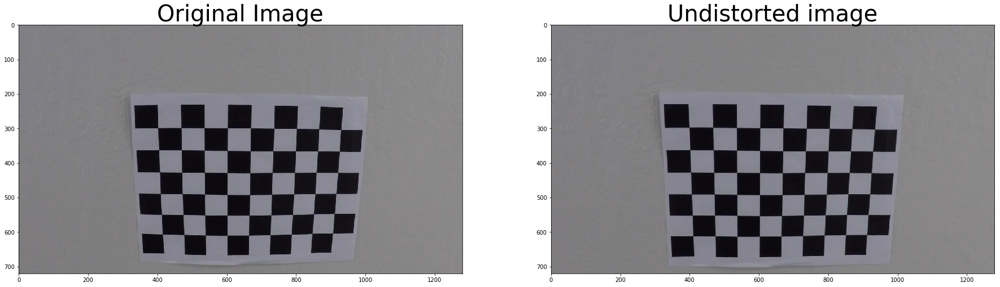

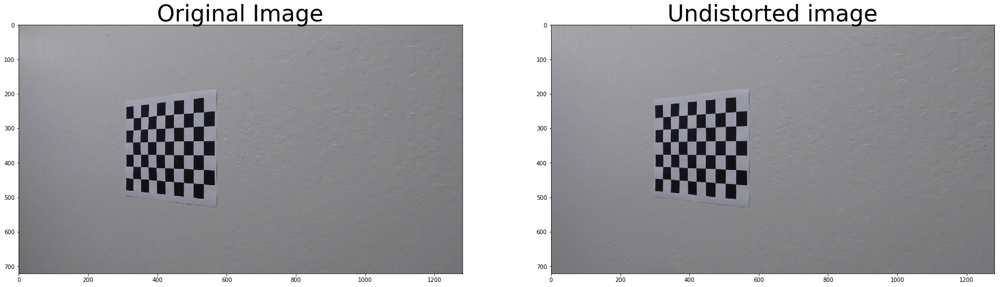

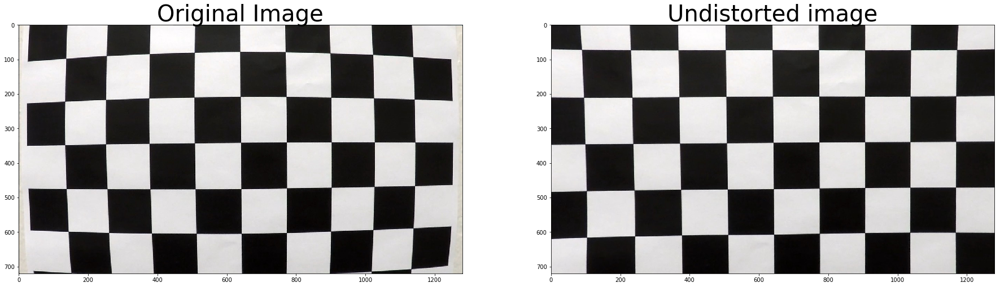

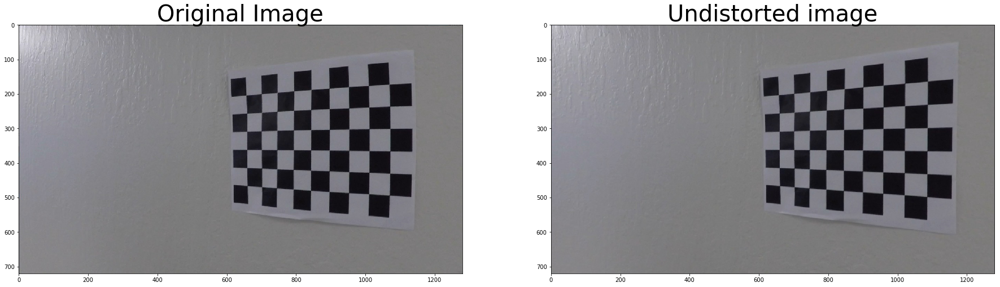

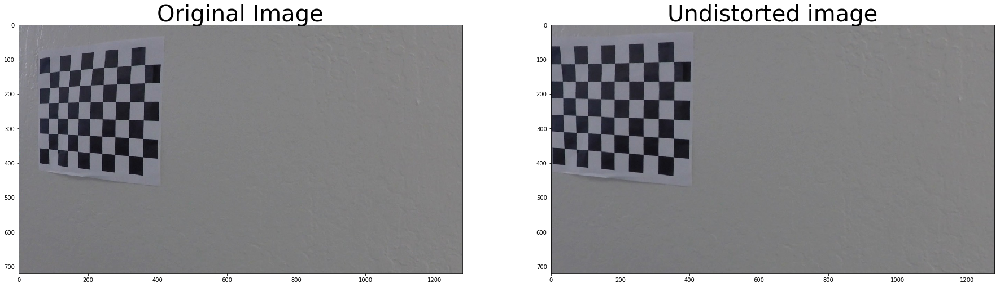

...

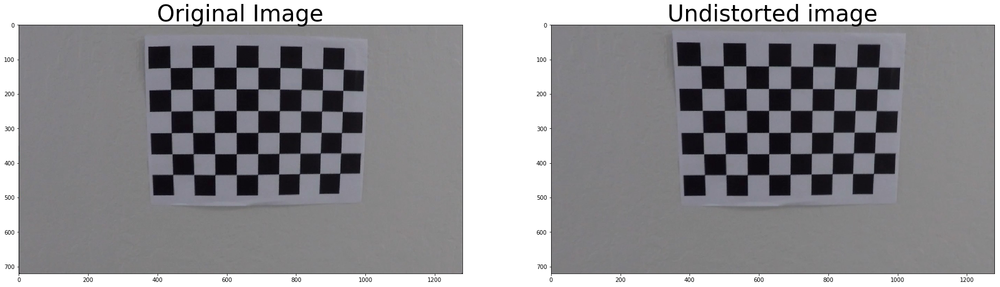

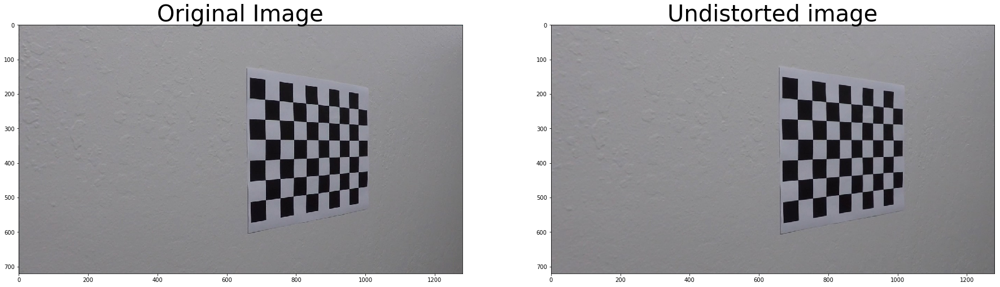

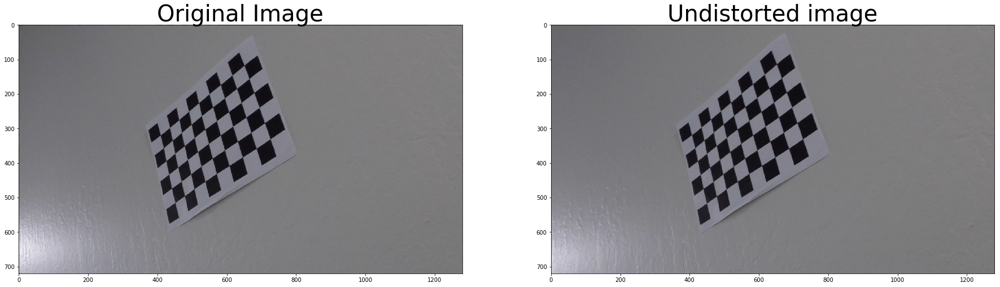

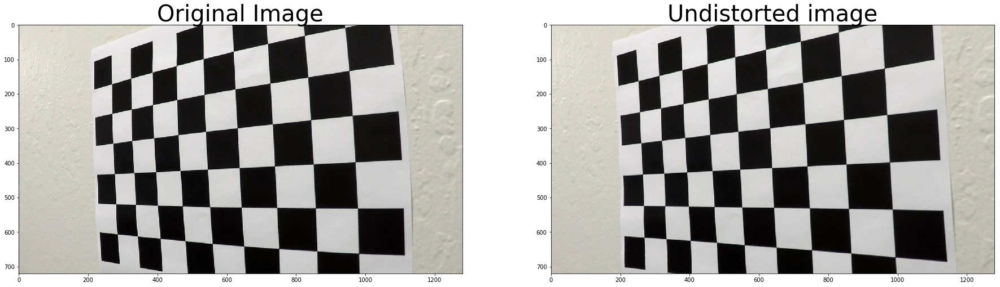

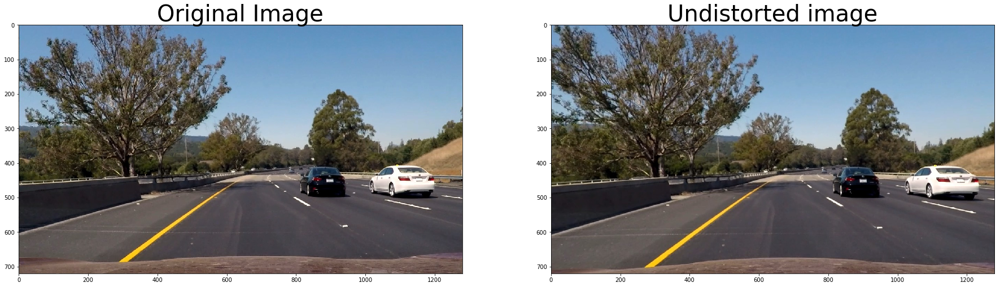

output_images/undist_test1.jpg


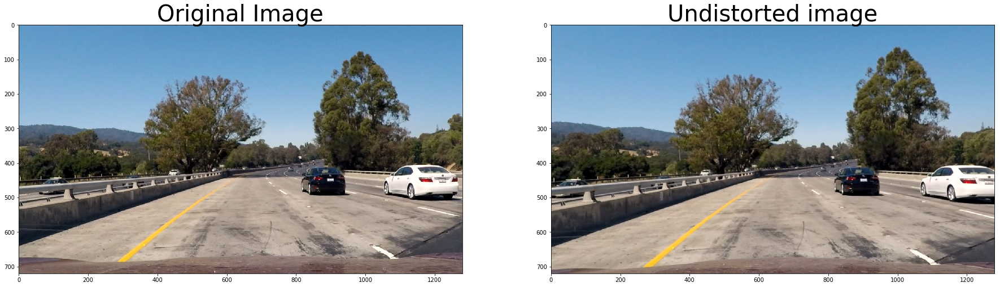

output_images/undist_test2.jpg


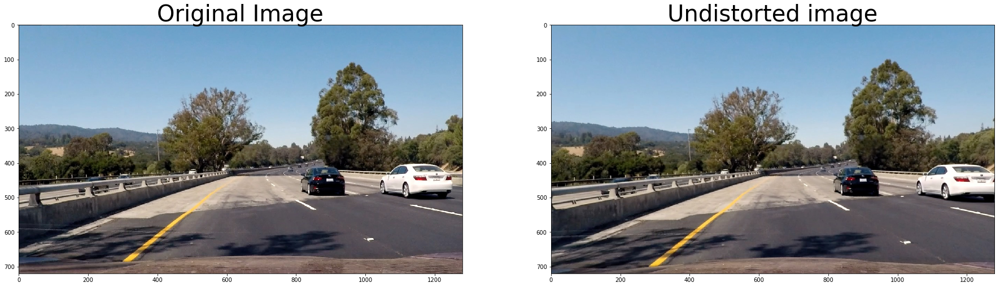

output_images/undist_test3.jpg


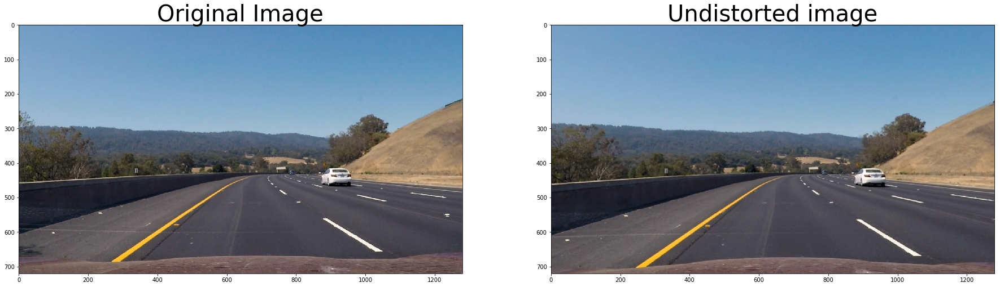

output_images/undist_test4.jpg


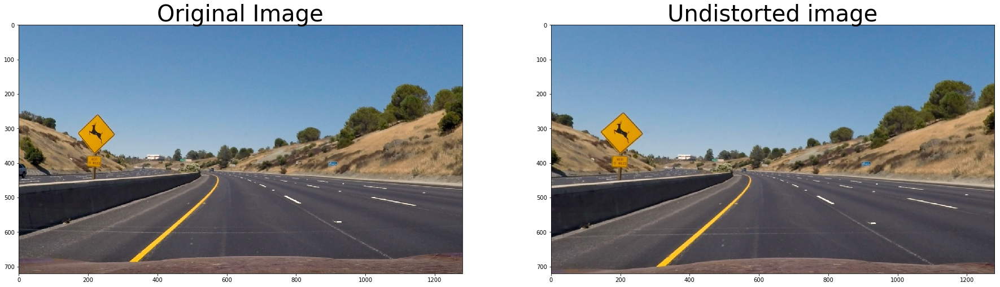

output_images/undist_test5.jpg


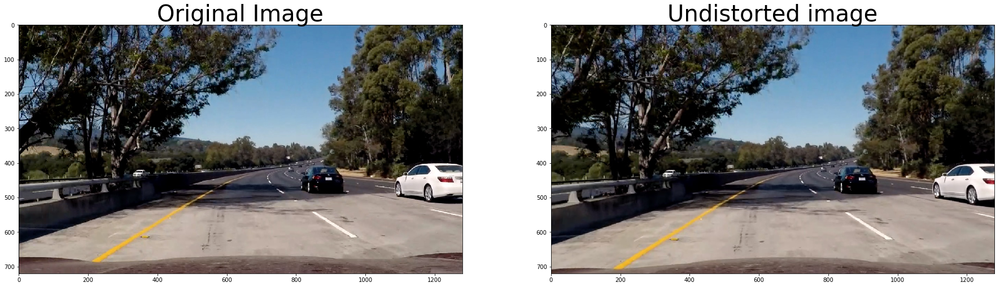

output_images/undist_test6.jpg


In [8]:

cnt = 1
print('conversion matrix: ', mtx)
print('distortion matrix: ', dist)

# Undistorting the calibration images
for path in cal_paths:
    # Reading distorted test image
    test_image = mpimg.imread(path)
    
    # Undistorting the image
    undst_image = cv2.undistort(test_image, mtx, dist, None, mtx)
    
    #plotting the original image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.set_title('Original Image', fontsize=40)
    ax1.imshow(test_image)
    ax2.imshow(undst_image)
    ax2.set_title('Undistorted image', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
    # Saving the images
    undst_image = cv2.cvtColor(undst_image, cv2.COLOR_RGB2BGR)
    outname = "output_images/undist_cal"+str(cnt)+".jpg"
    cv2.imwrite(outname,undst_image)
    cnt+=1

# Reading the test images paths
test_paths = glob.glob('test_images/test*.jpg')
cnt = 1
# Undistorting the test images
for path in test_paths:
    # Reading distorted test image
    test_image = mpimg.imread(path)
    
    # Undistorting the image
    undst_image = cv2.undistort(test_image, mtx, dist, None, mtx)
    
    #plotting the original image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.set_title('Original Image', fontsize=40)
    ax1.imshow(test_image)
    ax2.imshow(undst_image)
    ax2.set_title('Undistorted image', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
    undst_image = cv2.cvtColor(undst_image, cv2.COLOR_RGB2BGR)
    outname = "output_images/undist_test"+str(cnt)+".jpg"
    print(outname)
    cv2.imwrite(outname,undst_image)
    cnt+=1



# 2- Thresholded binary images

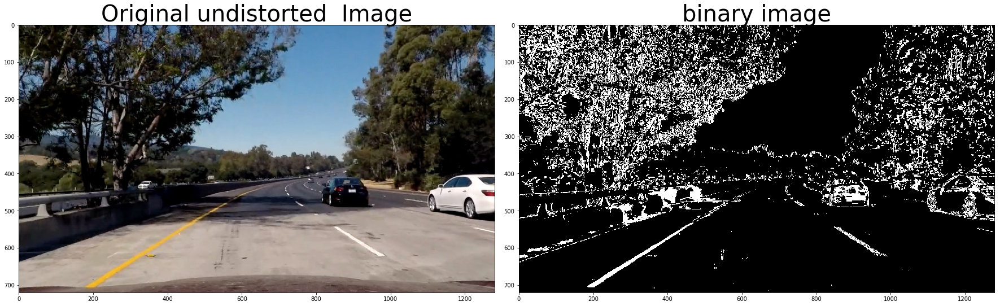

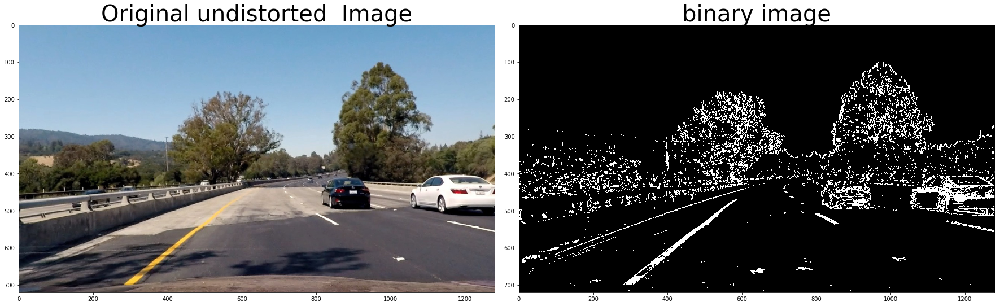

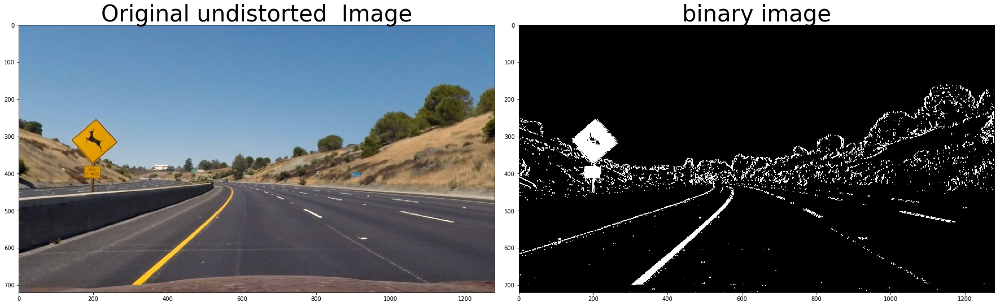

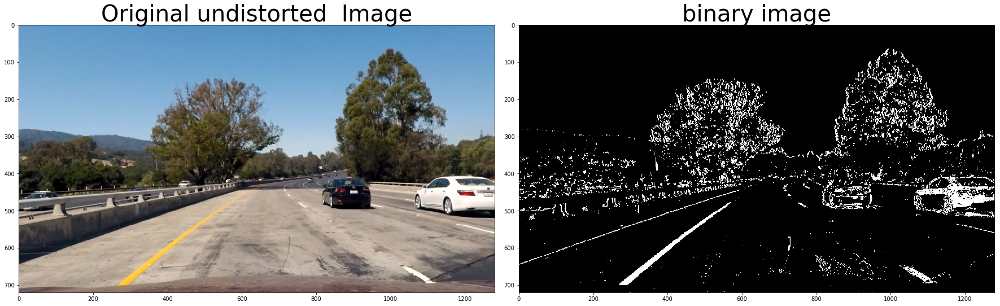

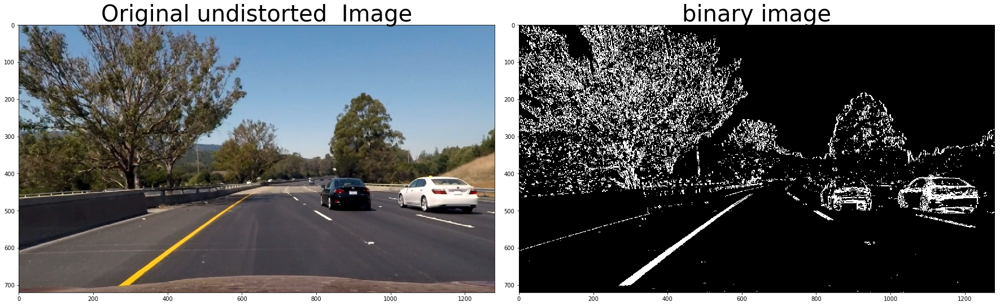

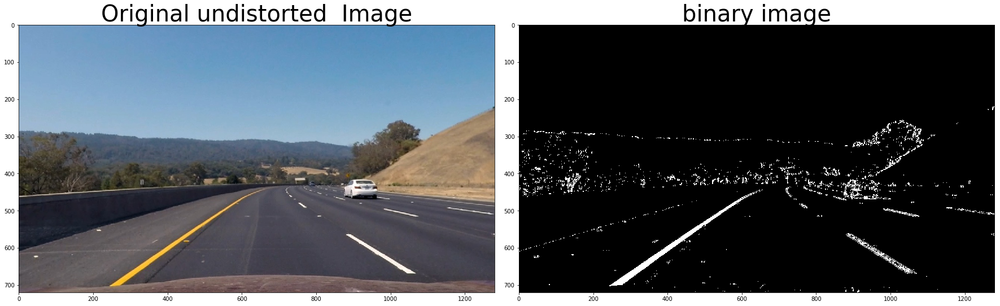

In [11]:


# Edit this function to create your own pipeline.
def pipeline(img, s_thresh=(165, 255), sx_thresh=(25, 110)):
    img = np.copy(img)
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return combined_binary

undist_paths = glob.glob('output_images/undist_test*.jpg')

for path in undist_paths:
    image = mpimg.imread(path)
    result = pipeline(image)
    
    # Plotting the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original undistorted  Image', fontsize=40)
    ax2.imshow(result, cmap='gray')
    ax2.set_title('binary image', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

# 3- Prespective transform

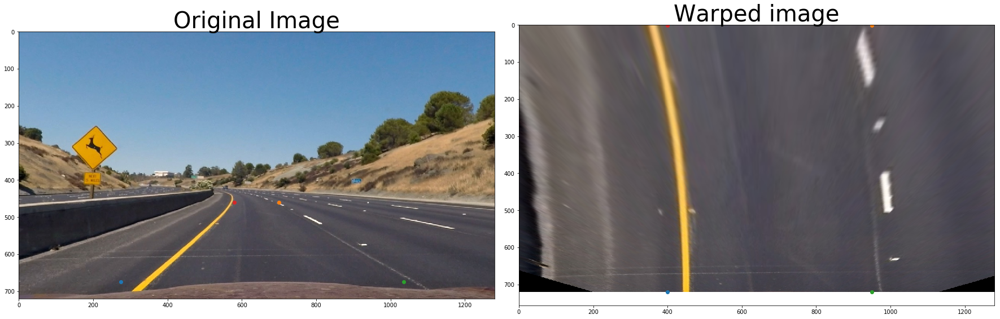

In [55]:
#function to change the perspective.
def Pers_transform(img, src_points, dst_points):
    # Computing the Transform matrix
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    # Reading the image size
    img_size = (img.shape[1], img.shape[0])
    #changing the image perspective
    warped_img = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped_img

img = mpimg.imread('test_images/straight_lines1.jpg')
img = mpimg.imread('test_images/test2.jpg')
img = cv2.undistort(img, mtx, dist, None, mtx)

src_points= np.float32([[275,675],[1035,675],[700,460],[580,460]])
dst_points= np.float32([[400,720],[950,720],[950,1],[400,1]])
warp_img = Pers_transform(img, src_points, dst_points)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.plot(src_points[0,0], src_points[0,1] , src_points[2,0] ,src_points[2,1] , marker = 'o')
ax1.plot(src_points[1,0], src_points[1,1] , src_points[3,0] ,src_points[3,1] , marker = 'o')
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(warp_img)
ax2.plot(dst_points[0,0], dst_points[0,1] , dst_points[2,0] , dst_points[2,1] , marker = 'o')
ax2.plot(dst_points[1,0], dst_points[1,1] , dst_points[3,0] , dst_points[3,1] , marker = 'o')
ax2.set_title('Warped image', fontsize=40)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

# 4- Detecting lanes and fitting curve

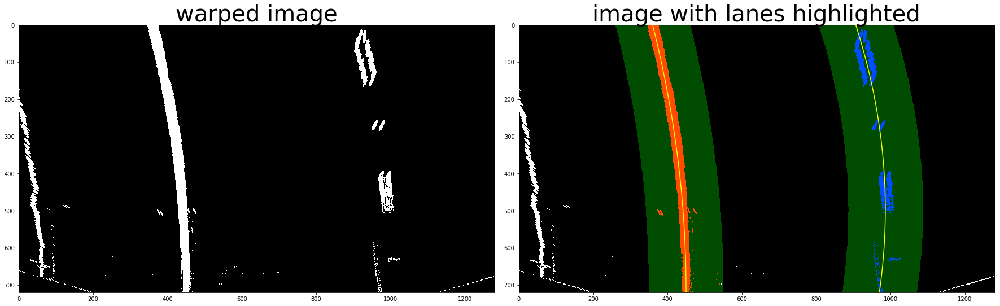

524.592420326 m 504.691683217 m


In [56]:
# Take a histogram of the bottom half of the image
def fit_curve(binary_warped):
    global left_fit,right_fit, left_fitx,right_fitx,left_fity, right_fity,leftx,rightx, ploty
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    # Generate a polygon to illustrate the search window are
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return result
# function to compute the right and left lanes raduis curvature
def calc_curve(left_fit,right_fit,ploty):
    global leftx,rightx
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    quadratic_coeff = 3e-4 
    
    leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                              for y in ploty])
    rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                for y in ploty])

    leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    rightx = rightx[::-1]  # Reverse to match top-to-bottom in y
    # Example values: 1926.74 1908.48
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    # Fit new polynomials to x,y in world space
    
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    
    # Example values: 632.1 m    626.2 m
    return right_curverad, left_curverad

warp_img = Pers_transform(img, src_points, dst_points)
warp_img = pipeline(warp_img, s_thresh=(165, 255), sx_thresh=(25, 110))
result = fit_curve(warp_img)

right_curverad, left_curverad = calc_curve(left_fit,right_fit,ploty)

 # Plotting the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(warp_img, cmap='gray')
ax1.set_title('warped image', fontsize=40)
ax2.imshow(result)
ax2.plot(left_fitx, ploty, color='yellow')
ax2.plot(right_fitx, ploty, color='yellow')
ax2.set_title('image with lanes highlighted', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

print(left_curverad, 'm', right_curverad, 'm')




# 5- warping back to the original image

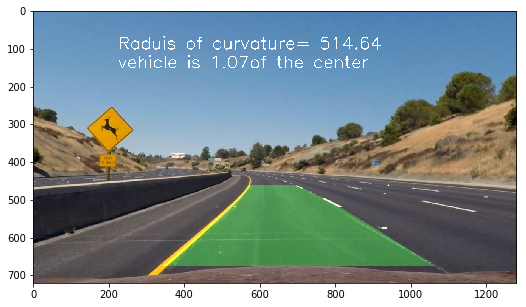

True

In [57]:
# Function to warp back the image.
def warp_back(warped,img):
    Minv = cv2.getPerspectiveTransform(dst_points, src_points)
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    
    curverad = (right_curverad+left_curverad)/2
    
    # computing the vehicle position
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    cam_pos = image.shape[0]/2
    lane_center = (leftx[719] + rightx[719])/2
    pos = abs((lane_center - cam_pos)*xm_per_pix)
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result,' Raduis of curvature= '+ str('%.2f' %curverad) ,(200,100), font, 1.5,(255,255,255),2)
    cv2.putText(result,' vehicle is '+ str('%.2f' %pos)+ 'of the center' ,(200,150), font, 1.5,(255,255,255),2)
    
    return result
f, ax= plt.subplots(1, 1, figsize=(12, 5))

result = warp_back(warp_img, img)
ax.imshow(result)
plt.show()

result1 = cv2.cvtColor(result, cv2.COLOR_RGB2BGR)
outname = "output_images/lanes_text.jpg"
cv2.imwrite(outname,result1)


## Image processing pipeline

In [49]:
"""
Applies an image mask.
    
Only keeps the region of the image defined by the polygon
formed from `vertices`. The rest of the image is set to black.
"""
def region_of_interest(img, vertices):
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

# Function to search the lanes in the nearby of the lanes
# found at the last search
def margin_search(binary_warped):
    global left_fit,right_fit, left_fitx,right_fitx,left_fity, right_fity, ploty
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 30
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return 



first = 1
# This function contains the whole pipeline for finding lanes
# from a distorted image and 
def main_pipeline(img):
    global leftx , rightx,left_fitx, right_fitx,ploty, left_fit,right_fit,left_curverad, right_curverad,first 
    und_img = cv2.undistort(img, mtx, dist, None, mtx)
    src_points= np.float32([[275,675],[1035,675],[700,460],[580,460]])
    dst_points= np.float32([[400,720],[950,720],[950,1],[400,1]])
    
    # Points to define the image mask
    p1 = np.array((img.shape[1]*0.27, img.shape[0]*0.98), dtype=np.int32)
    p2 = np.array((img.shape[1]*0.27, img.shape[0]*0.001), dtype=np.int32)
    p3 = np.array((img.shape[1]*0.83, img.shape[0]*0.001), dtype=np.int32)
    p4 = np.array((img.shape[1]*0.83,img.shape[0]*0.98), dtype=np.int32)
    
    
    vertices = np.array([[p1,p2,p3,p4]], dtype=np.int32)
    
    # changing the perspective
    warped = Pers_transform(und_img, src_points, dst_points)
    # transforming to thresholded binary image
    warped = pipeline(warped, s_thresh=(165, 255), sx_thresh=(25, 110))
    # masking the image to use only the region of interest
    mask_wrp = region_of_interest(warped, vertices)
    
    # use the sliding window search at first 
    if first == 1:
        output = fit_curve(mask_wrp)
        first =0
    else:
        # using margin search in a second step
        margin_search(mask_wrp)
    
    right_curverad, left_curverad = calc_curve(left_fit,right_fit,ploty)
    
    resultf = warp_back(warped,img)
    return resultf



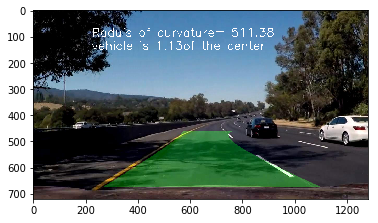

In [48]:
# this cell is used for test purposes for difficult images.
from moviepy.editor import VideoFileClip

clip0 = VideoFileClip("project_video.mp4")
clip0.save_frame("video_images/img2.jpg", t=(41.70), withmask=True)

first = 1
img = mpimg.imread('video_images/img2.jpg')
result2  = main_pipeline(img)
plt.imshow(result2)
plt.show()

# 6- Processing the video

In [58]:
from moviepy.editor import VideoFileClip

test_output = 'output_video.mp4'

clip1 = VideoFileClip("project_video.mp4")
first = 1
output_clip = clip1.fl_image(main_pipeline) #NOTE: this function expects color images!!
%time output_clip.write_videofile(test_output, audio=False)

[MoviePy] >>>> Building video output_video.mp4
[MoviePy] Writing video output_video.mp4


100%|█████████▉| 1260/1261 [04:02<00:00,  5.38it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video.mp4 

CPU times: user 5min 41s, sys: 3.46 s, total: 5min 44s
Wall time: 4min 5s
